In [86]:
import os
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xarray as xr
import pyproj

# Add icedrift to the system path
sys.path.append('/Users/aless/Desktop/icedrift/src')

# Import necessary functions from icedrift
from icedrift.analysis import compute_velocity, compute_absolute_dispersion, compute_along_across_components
from icedrift.interpolation import interpolate_buoy_track

# Set plot style
sns.set(style="whitegrid")


In [87]:
# Define the directory containing the cleaned mosaic_dn1 buoy data
mosaic_dn1_data_dir = '../data/buoy_data/mosaic_dn1/cleaned_data/'

# List all CSV files in the directory
mosaic_dn1_files = [f for f in os.listdir(mosaic_dn1_data_dir) if f.endswith('.csv')]

# Number of buoys to process
num_buoys = 50  # Adjust as needed

# Initialize an empty list to store DataFrames
buoy_data_list = []

# Load each CSV and append to the list
for file in mosaic_dn1_files[:num_buoys]:
    buoy_id = os.path.splitext(file)[0]  # Removes the .csv extension
    file_path = os.path.join(mosaic_dn1_data_dir, file)
    
    # Read CSV with 'datetime' parsed as datetime objects
    df = pd.read_csv(file_path, parse_dates=['datetime'])
    
    # Add buoy_id to the DataFrame
    df['buoy_id'] = buoy_id
    
    # Append to the list
    buoy_data_list.append(df)

# Concatenate all buoy DataFrames into a single DataFrame
all_buoy_data = pd.concat(buoy_data_list, ignore_index=True)

print(f"Loaded data for {all_buoy_data['buoy_id'].nunique()} buoys.")
print(all_buoy_data.head())


Loaded data for 50 buoys.
             datetime  latitude  longitude         buoy_id
0 2019-10-07 06:01:42  84.99177  135.16769  cleaned_2019R9
1 2019-10-07 06:46:08  84.99010  135.19537  cleaned_2019R9
2 2019-10-07 07:05:15  84.98936  135.20749  cleaned_2019R9
3 2019-10-07 08:02:12  84.98712  135.24060  cleaned_2019R9
4 2019-10-07 09:01:54  84.98476  135.27460  cleaned_2019R9


In [88]:
# Initialize a dictionary to store interpolated buoy data
buoy_data_interp = {}

# Get the list of unique buoy IDs
buoy_ids = all_buoy_data['buoy_id'].unique()

for buoy_id in buoy_ids:
    # Extract data for the current buoy
    buoy_df = all_buoy_data[all_buoy_data['buoy_id'] == buoy_id].copy()
    
    # Ensure the DataFrame is sorted by datetime
    buoy_df = buoy_df.sort_values('datetime').reset_index(drop=True)
    
    # Set 'datetime' as the index
    buoy_df.set_index('datetime', inplace=True)
    
    # Interpolate buoy track to hourly frequency with a maximum gap of 4 hours (240 minutes)
    interpolated_df = interpolate_buoy_track(
        buoy_df, 
        freq='1h',  # Hourly frequency
        maxgap_minutes=240  # Maximum gap of 4 hours
    ).loc[:, ['longitude', 'latitude']]  # Select relevant columns
    
    # Add buoy_id back to the interpolated DataFrame
    interpolated_df['buoy_id'] = buoy_id
    
    # Store in the dictionary
    buoy_data_interp[buoy_id] = interpolated_df

print("Interpolated buoy data to hourly frequency.")


Interpolated buoy data to hourly frequency.


In [89]:
# Initialize a dictionary to store daily resampled data with velocity
buoy_data_daily = {}

for buoy_id, df in buoy_data_interp.items():
    # Resample to daily frequency at 12:00 UTC
    # '24h' frequency starting from the first timestamp
    daily = df.resample('24h', origin='start').asfreq().dropna()
    
    # Compute velocities
    # Assuming 'compute_velocity' requires the DataFrame to have 'longitude' and 'latitude' columns
    # and that it adds 'u', 'v', and 'speed' columns
    daily = compute_velocity(daily, date_index=True, rotate_uv=False, method='c')
    
    # Add buoy_id to the daily DataFrame
    daily['buoy_id'] = buoy_id
    
    # Store in the dictionary
    buoy_data_daily[buoy_id] = daily

print("Velocity computation complete.")
print("Resampled buoy data to daily frequency at 12:00 UTC.")


Velocity computation complete.
Resampled buoy data to daily frequency at 12:00 UTC.


In [90]:
# Define the SIC extraction function (as provided)
def sic_along_track(position_data, sic_ds):
    """
    Uses xarray advanced interpolation to get along-track SIC via nearest neighbors.
    
    Parameters:
    - position_data: DataFrame with 'datetime', 'longitude', 'latitude'
    - sic_ds: xarray Dataset with 'sea_ice_concentration'
    
    Returns:
    - pandas Series with SIC values aligned to position_data index
    """
    # Define coordinate reference systems
    crs_wgs84 = pyproj.CRS('EPSG:4326')  # WGS 84
    crs_stere = pyproj.CRS(
        '+proj=stere +lat_0=90 +lat_ts=70 +lon_0=-45 '
        '+k=1 +x_0=0 +y_0=0 +a=6378273 +b=6356889.449 '
        '+units=m +no_defs'
    )
    transformer = pyproj.Transformer.from_crs(crs_wgs84, crs_stere, always_xy=True)
    
    # Initialize SIC series
    sic = pd.Series(data=np.nan, index=position_data.index)
    
    for date, group in position_data.groupby(position_data['datetime'].dt.date):
        try:
            # Transform coordinates to stereographic projection
            x_stere, y_stere = transformer.transform(group['longitude'].values, group['latitude'].values)
            
            # Create DataArrays for interpolation
            x = xr.DataArray(x_stere, dims="points")
            y = xr.DataArray(y_stere, dims="points")
            
            # Select SIC data for the current date
            sic_daily = sic_ds.sel(time=date.strftime('%Y-%m-%d'))
            
            # Perform nearest neighbor interpolation
            sic_values = sic_daily['sea_ice_concentration'].interp(
                x=x,
                y=y,
                method='nearest'
            ).values
            
            # Assign SIC values to the corresponding positions
            sic.loc[group.index] = np.round(sic_values, 3)
        except KeyError:
            # Handle dates not present in SIC data
            sic.loc[group.index] = np.nan
    
    # Replace SIC values greater than 100 with NaN
    sic[sic > 100] = np.nan
    return sic

# Load SIC data
sic_file = '../NSIDC Sea Ice Concentration/nsidc_daily_sic_cdr_2020.nc'
sic_data = xr.open_dataset(sic_file)

# Reformat NSIDC data for convenience with interpolation -- rename coordinates and dimensions
ds = xr.Dataset({
    'sea_ice_concentration': (('time', 'y', 'x'), sic_data['cdr_seaice_conc'].data)
},
coords={
    'time': ('time', pd.to_datetime(sic_data.time.data)),
    'x': ('x', sic_data['xgrid'].data),
    'y': ('y', sic_data['ygrid'].data)
})

print("Loaded and reformatted SIC data.")


Loaded and reformatted SIC data.


In [91]:
# Concatenate all buoy data into a single DataFrame
all_positions_daily = pd.concat(buoy_data_daily.values())

# Reset index to make 'datetime' a column
all_positions_daily.reset_index(inplace=True)

print("Combined all buoys into all_positions_daily.")
print(all_positions_daily.head())
print(all_positions_daily.columns)


Combined all buoys into all_positions_daily.
             datetime  longitude  latitude         buoy_id             x  \
0 2019-10-07 07:00:00  135.20421  84.98956  cleaned_2019R9  -1935.677603   
1 2019-10-08 07:00:00  136.83926  84.89965  cleaned_2019R9 -17744.313993   
2 2019-10-09 07:00:00  136.75039  84.82115  cleaned_2019R9 -17147.461779   
3 2019-10-10 07:00:00  136.18291  84.83637  cleaned_2019R9 -11555.095611   
4 2019-10-11 07:00:00  136.38422  84.77745  cleaned_2019R9 -13675.699102   

               y         u         v     speed  
0  543096.261478       NaN       NaN       NaN  
1  552572.804384 -0.088031  0.104280  0.136469  
2  561115.819567  0.035817  0.040704  0.054219  
3  559606.514115  0.020091  0.028009  0.034470  
4  565955.836886 -0.025357  0.043710  0.050532  
Index(['datetime', 'longitude', 'latitude', 'buoy_id', 'x', 'y', 'u', 'v',
       'speed'],
      dtype='object')


In [92]:
# Extract SIC values and add to all_positions_daily
all_positions_daily['sea_ice_concentration'] = sic_along_track(all_positions_daily, ds)

# Verify the column exists
print("Columns in all_positions_daily after SIC extraction:")
print(all_positions_daily.columns)


Columns in all_positions_daily after SIC extraction:
Index(['datetime', 'longitude', 'latitude', 'buoy_id', 'x', 'y', 'u', 'v',
       'speed', 'sea_ice_concentration'],
      dtype='object')


In [93]:
# Interpolate missing 'speed' values
all_positions_daily['speed'] = all_positions_daily['speed'].interpolate(method='linear')

# Forward fill any remaining NaNs
all_positions_daily['speed'] = all_positions_daily['speed'].fillna(method='ffill').fillna(method='bfill')

# Check the total number of NaNs in the 'speed' column
total_speed_nans = all_positions_daily['speed'].isna().sum()
print(f"Total NaN values in 'speed': {total_speed_nans}")

# Identify datetime groups where all 'speed' values are NaN
speed_nan_groups = all_positions_daily.groupby('datetime')['speed'].apply(lambda x: x.isna().all())
nan_dates = speed_nan_groups[speed_nan_groups].index.tolist()

print(f"Dates with all 'speed' values as NaN: {nan_dates}")

# Display rows where 'speed' is NaN
nan_speed_rows = all_positions_daily[all_positions_daily['speed'].isna()]
print("Rows with NaN 'speed' values:")
print(nan_speed_rows)


Total NaN values in 'speed': 0
Dates with all 'speed' values as NaN: []
Rows with NaN 'speed' values:
Empty DataFrame
Columns: [datetime, longitude, latitude, buoy_id, x, y, u, v, speed, sea_ice_concentration]
Index: []


/var/folders/lm/jq7cgq_91z98cg7sw6wybytw0000gn/T/ipykernel_2172/941635688.py:5: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  all_positions_daily['speed'] = all_positions_daily['speed'].fillna(method='ffill').fillna(method='bfill')


In [94]:
# Set SIC > 1 to NaN
all_positions_daily.loc[all_positions_daily['sea_ice_concentration'] > 1, 'sea_ice_concentration'] = np.nan

# Verify the cleaning process
num_nan_sic = all_positions_daily['sea_ice_concentration'].isna().sum()
print(f"Number of SIC values set to NaN: {num_nan_sic}")

# Ensure no SIC values >1 remain
max_sic = all_positions_daily['sea_ice_concentration'].max()
print(f"Maximum SIC after cleaning: {max_sic}")

# Assertion to ensure data integrity
assert max_sic <= 1 or pd.isna(max_sic), "There are SIC values greater than 1 that are not set to NaN."


Number of SIC values set to NaN: 2847
Maximum SIC after cleaning: 1.0


In [95]:
# Ensure 'datetime' is in datetime format
all_positions_daily['datetime'] = pd.to_datetime(all_positions_daily['datetime'])

# Create a copy of 'datetime' to keep as a separate column
all_positions_daily['datetime_copy'] = all_positions_daily['datetime']

# Set 'datetime' as the index for resampling
all_positions_daily.set_index('datetime', inplace=True)

# Calculate rolling 24-hour mean for drift speed
all_positions_daily['rolling_mean_speed'] = all_positions_daily['speed'].rolling(window=24, min_periods=1).mean()

# Calculate anomalies
all_positions_daily['speed_anomaly'] = all_positions_daily['speed'] - all_positions_daily['rolling_mean_speed']

# Verify the calculation
print(all_positions_daily[['speed', 'rolling_mean_speed', 'speed_anomaly', 'datetime_copy']].head())



                        speed  rolling_mean_speed  speed_anomaly  \
datetime                                                           
2019-10-07 07:00:00  0.136469            0.136469       0.000000   
2019-10-08 07:00:00  0.136469            0.136469       0.000000   
2019-10-09 07:00:00  0.054219            0.109052      -0.054833   
2019-10-10 07:00:00  0.034470            0.090407      -0.055937   
2019-10-11 07:00:00  0.050532            0.082432      -0.031900   

                          datetime_copy  
datetime                                 
2019-10-07 07:00:00 2019-10-07 07:00:00  
2019-10-08 07:00:00 2019-10-08 07:00:00  
2019-10-09 07:00:00 2019-10-09 07:00:00  
2019-10-10 07:00:00 2019-10-10 07:00:00  
2019-10-11 07:00:00 2019-10-11 07:00:00  


In [96]:
# Resample to daily frequency and compute statistics
daily_median_anomaly = all_positions_daily['speed_anomaly'].resample('D').median()
daily_min_anomaly = all_positions_daily['speed_anomaly'].resample('D').min()
daily_max_anomaly = all_positions_daily['speed_anomaly'].resample('D').max()

# Verify the results
print(daily_median_anomaly.head())
print(daily_min_anomaly.head())
print(daily_max_anomaly.head())


datetime
2019-09-29    0.036527
2019-09-30    0.017128
2019-10-01   -0.037888
2019-10-02   -0.056840
2019-10-03   -0.031468
Freq: D, Name: speed_anomaly, dtype: float64
datetime
2019-09-29    0.036527
2019-09-30    0.017128
2019-10-01   -0.047245
2019-10-02   -0.064387
2019-10-03   -0.062869
Freq: D, Name: speed_anomaly, dtype: float64
datetime
2019-09-29    0.036527
2019-09-30    0.017128
2019-10-01   -0.028531
2019-10-02   -0.049293
2019-10-03   -0.000067
Freq: D, Name: speed_anomaly, dtype: float64


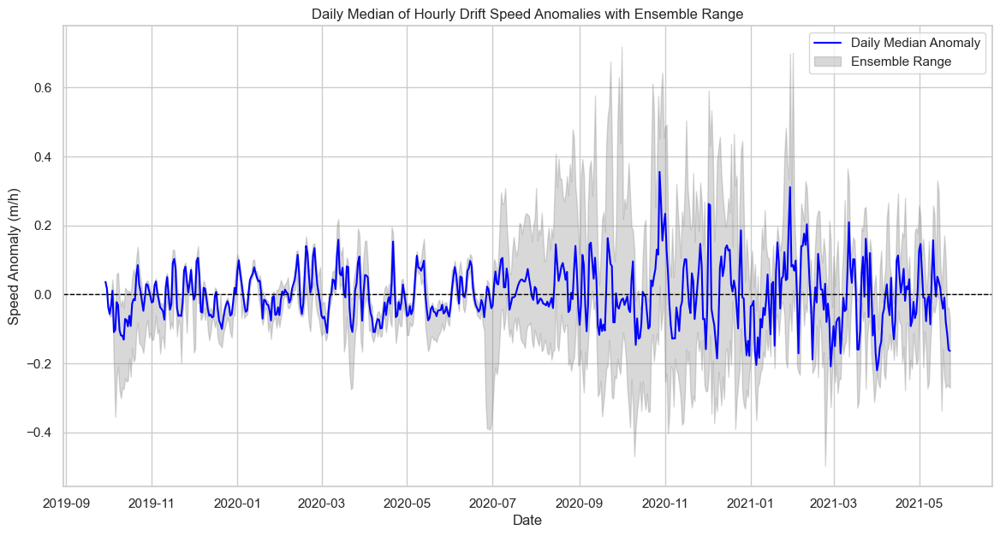

Median of daily median anomalies: -0.009 m/h


In [97]:
# Plot the daily median anomalies with ensemble range
plt.figure(figsize=(14, 7))
plt.plot(daily_median_anomaly.index, daily_median_anomaly, label='Daily Median Anomaly', color='blue')
plt.fill_between(
    daily_median_anomaly.index,
    daily_min_anomaly,
    daily_max_anomaly,
    color='gray',
    alpha=0.3,
    label='Ensemble Range'
)
plt.axhline(0, color='black', linestyle='--', linewidth=1)
plt.xlabel('Date')
plt.ylabel('Speed Anomaly (m/h)')
plt.title('Daily Median of Hourly Drift Speed Anomalies with Ensemble Range')
plt.legend()
plt.show()

# Verify that the median is close to zero
median_of_medians = daily_median_anomaly.median()
print(f"Median of daily median anomalies: {median_of_medians:.3f} m/h")


In [98]:
# Calculate drift speed statistics
drift_speed_stats = all_positions_daily.groupby('datetime').agg(
    median_speed=('speed', 'median'),
    IQR_lower_speed=('speed', lambda x: x.quantile(0.25)),
    IQR_upper_speed=('speed', lambda x: x.quantile(0.75))
).reset_index()

# Calculate sea ice concentration statistics
sic_stats = all_positions_daily.groupby('datetime').agg(
    median_sic=('sea_ice_concentration', 'median'),
    IQR_lower_sic=('sea_ice_concentration', lambda x: x.quantile(0.25)),
    IQR_upper_sic=('sea_ice_concentration', lambda x: x.quantile(0.75))
).reset_index()

print("Statistical calculations complete.")
print(drift_speed_stats.head())
print(sic_stats.head())


Statistical calculations complete.
             datetime  median_speed  IQR_lower_speed  IQR_upper_speed
0 2019-09-29 05:00:00      0.121353         0.121353         0.121353
1 2019-09-30 05:00:00      0.101284         0.101284         0.101284
2 2019-10-01 04:00:00      0.070939         0.070939         0.070939
3 2019-10-01 05:00:00      0.054230         0.054230         0.054230
4 2019-10-02 04:00:00      0.043874         0.043874         0.043874
             datetime  median_sic  IQR_lower_sic  IQR_upper_sic
0 2019-09-29 05:00:00         NaN            NaN            NaN
1 2019-09-30 05:00:00         NaN            NaN            NaN
2 2019-10-01 04:00:00         NaN            NaN            NaN
3 2019-10-01 05:00:00         NaN            NaN            NaN
4 2019-10-02 04:00:00         NaN            NaN            NaN


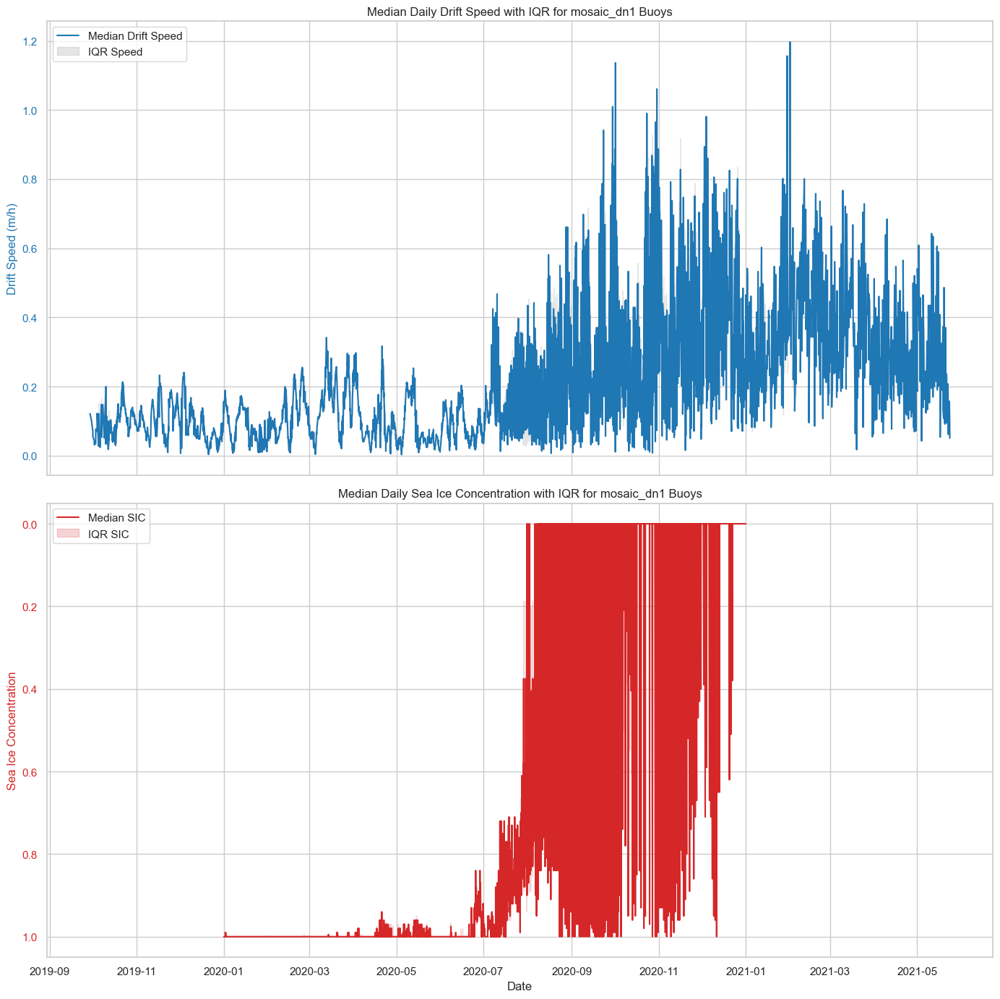

In [99]:
# Create subplots
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 14), sharex=True)

# Plot Median Drift Speed
color = 'tab:blue'
ax1.set_ylabel('Drift Speed (m/h)', color=color)
ax1.plot(drift_speed_stats['datetime'], drift_speed_stats['median_speed'], label='Median Drift Speed', color=color)
ax1.fill_between(
    drift_speed_stats['datetime'],
    drift_speed_stats['IQR_lower_speed'],
    drift_speed_stats['IQR_upper_speed'],
    color="gray",
    alpha=0.2,
    label='IQR Speed'
)
ax1.tick_params(axis='y', labelcolor=color)
ax1.legend(loc='upper left')
ax1.set_title('Median Daily Drift Speed with IQR for mosaic_dn1 Buoys')

# Plot Median Sea Ice Concentration
color = 'tab:red'
ax2.set_ylabel('Sea Ice Concentration', color=color)
ax2.plot(sic_stats['datetime'], sic_stats['median_sic'], label='Median SIC', color=color)
ax2.fill_between(
    sic_stats['datetime'],
    sic_stats['IQR_lower_sic'],
    sic_stats['IQR_upper_sic'],
    color=color,
    alpha=0.2,
    label='IQR SIC'
)
ax2.tick_params(axis='y', labelcolor=color)
ax2.legend(loc='upper left')
ax2.set_title('Median Daily Sea Ice Concentration with IQR for mosaic_dn1 Buoys')
ax2.invert_yaxis()  # Invert y-axis if higher SIC values represent more ice

# Common X-axis label
plt.xlabel('Date')

# Adjust layout
plt.tight_layout()

# Display the plot
plt.show()


Index(['longitude', 'latitude', 'buoy_id', 'x', 'y', 'u', 'v', 'speed',
       'sea_ice_concentration', 'datetime_copy', 'rolling_mean_speed',
       'speed_anomaly'],
      dtype='object')


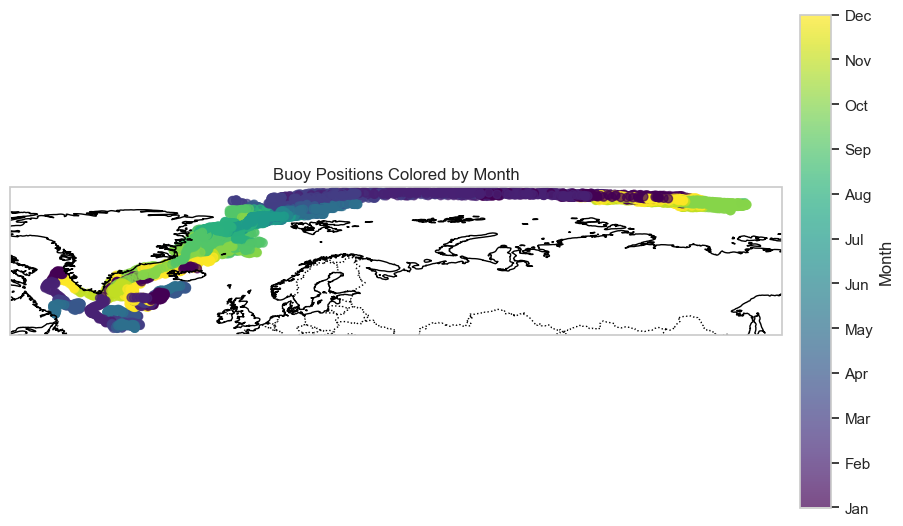

In [102]:
print(all_positions_daily.columns)

# Extract month from datetime
all_positions_daily['month'] = all_positions_daily['datetime_copy'].dt.month
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Define a color palette for months
cmap = plt.get_cmap('viridis', 12)  # 12 discrete colors for 12 months

plt.figure(figsize=(12, 8))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, linestyle=':')

# Scatter plot colored by month
scatter = ax.scatter(
    all_positions_daily['longitude'], 
    all_positions_daily['latitude'],
    c=all_positions_daily['month'],
    cmap='viridis',
    alpha=0.7,
    transform=ccrs.PlateCarree()
)

# Add colorbar with month labels
cbar = plt.colorbar(scatter, orientation='vertical', pad=0.02, aspect=16, shrink=0.8)
cbar.set_label('Month')
cbar.set_ticks(range(1,13))
cbar.set_ticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                     'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])

plt.title('Buoy Positions Colored by Month')
plt.show()


In [106]:
# Calculate median geographic position
median_lat = all_positions_daily['latitude'].median()
median_lon = all_positions_daily['longitude'].median()

print(f"Median Latitude: {median_lat}, Median Longitude: {median_lon}")

# Define a geographic window (e.g., ±1 degree)
window = 1.0  # degrees

median_region = all_positions_daily[
    (all_positions_daily['latitude'] >= median_lat - window) &
    (all_positions_daily['latitude'] <= median_lat + window) &
    (all_positions_daily['longitude'] >= median_lon - window) &
    (all_positions_daily['longitude'] <= median_lon + window)
]

print(f"Number of data points in median region: {len(median_region)}")

# Check if wind data exists
if 'wind_speed' in median_region.columns and 'wind_direction' in median_region.columns:
    # Convert wind direction to u and v components
    median_region['u'] = median_region['wind_speed'] * np.cos(np.deg2rad(median_region['wind_direction']))
    median_region['v'] = median_region['wind_speed'] * np.sin(np.deg2rad(median_region['wind_direction']))
    
    # Plot quiver (vector) plot
    plt.figure(figsize=(10, 6))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    
    quiver = ax.quiver(
        median_region['longitude'], 
        median_region['latitude'],
        median_region['u'], 
        median_region['v'],
        median_region['wind_speed'],
        cmap='cool',
        scale=50,
        transform=ccrs.PlateCarree()
    )
    
    # Add colorbar
    cbar = plt.colorbar(quiver, orientation='vertical', pad=0.02, aspect=16, shrink=0.8)
    cbar.set_label('Wind Speed (m/s)')
    
    plt.title('Wind Vectors Along Median Position')
    plt.show()
else:
    print("Wind data ('wind_speed' and 'wind_direction') not found in the DataFrame.")



Median Latitude: 83.808255, Median Longitude: 12.269135
Number of data points in median region: 225
Wind data ('wind_speed' and 'wind_direction') not found in the DataFrame.


In [107]:
def plot_daily_median_anomaly(daily_median, daily_min, daily_max, title):
    plt.figure(figsize=(14, 7))
    plt.plot(daily_median.index, daily_median, label='Daily Median Anomaly', color='blue')
    plt.fill_between(
        daily_median.index,
        daily_min,
        daily_max,
        color='gray',
        alpha=0.3,
        label='Ensemble Range'
    )
    plt.axhline(0, color='black', linestyle='--', linewidth=1)
    plt.xlabel('Date')
    plt.ylabel('Speed Anomaly (m/h)')
    plt.title(title)
    plt.legend()
    plt.show()

def plot_monthly_colored_map(df, title):
    df['month'] = df.index.month
    plt.figure(figsize=(12, 8))
    ax = plt.axes(projection=ccrs.PlateCarree())
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    
    scatter = ax.scatter(
        df['longitude'], 
        df['latitude'],
        c=df['month'],
        cmap='viridis',
        alpha=0.7,
        transform=ccrs.PlateCarree()
    )
    
    cbar = plt.colorbar(scatter, orientation='vertical', pad=0.02, aspect=16, shrink=0.8)
    cbar.set_label('Month')
    cbar.set_ticks(range(1,13))
    cbar.set_ticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                         'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    
    plt.title(title)
    plt.show()

def plot_velocity_and_sic(drift_stats, sic_stats, title_speed, title_sic):
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 14), sharex=True)
    
    # Plot Median Drift Speed
    color = 'tab:blue'
    ax1.set_ylabel('Drift Speed (m/h)', color=color)
    ax1.plot(drift_stats['datetime'], drift_stats['median_speed'], label='Median Drift Speed', color=color)
    ax1.fill_between(
        drift_stats['datetime'],
        drift_stats['IQR_lower_speed'],
        drift_stats['IQR_upper_speed'],
        color="gray",
        alpha=0.2,
        label='IQR Speed'
    )
    ax1.tick_params(axis='y', labelcolor=color)
    ax1.legend(loc='upper left')
    ax1.set_title(title_speed)
    
    # Plot Median Sea Ice Concentration
    color = 'tab:red'
    ax2.set_ylabel('Sea Ice Concentration', color=color)
    ax2.plot(sic_stats['datetime'], sic_stats['median_sic'], label='Median SIC', color=color)
    ax2.fill_between(
        sic_stats['datetime'],
        sic_stats['IQR_lower_sic'],
        sic_stats['IQR_upper_sic'],
        color=color,
        alpha=0.2,
        label='IQR SIC'
    )
    ax2.tick_params(axis='y', labelcolor=color)
    ax2.legend(loc='upper left')
    ax2.set_title(title_sic)
    ax2.invert_yaxis()  # Invert y-axis if higher SIC indicates more ice
    
    # Common X-axis label
    plt.xlabel('Date')
    
    # Adjust layout
    plt.tight_layout()
    
    # Display the plot
    plt.show()


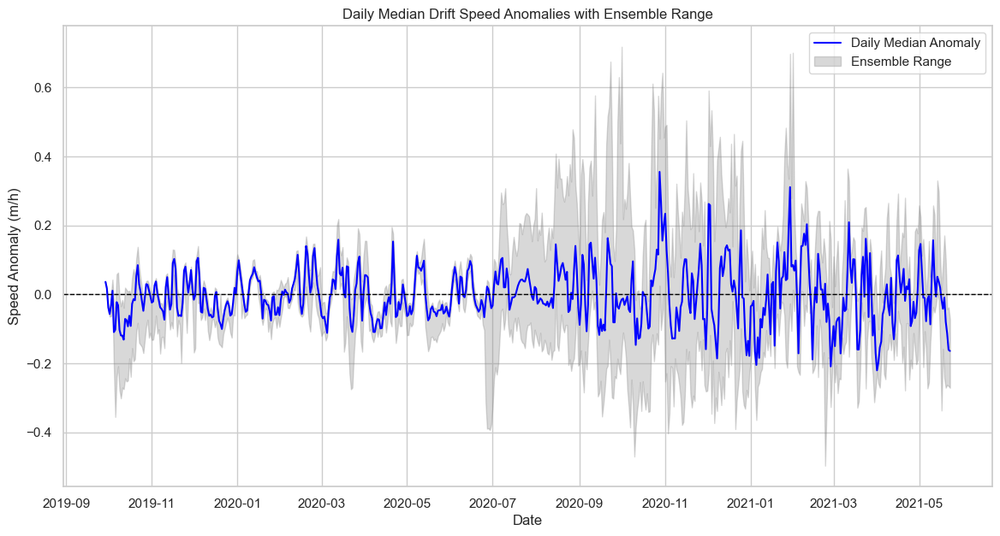

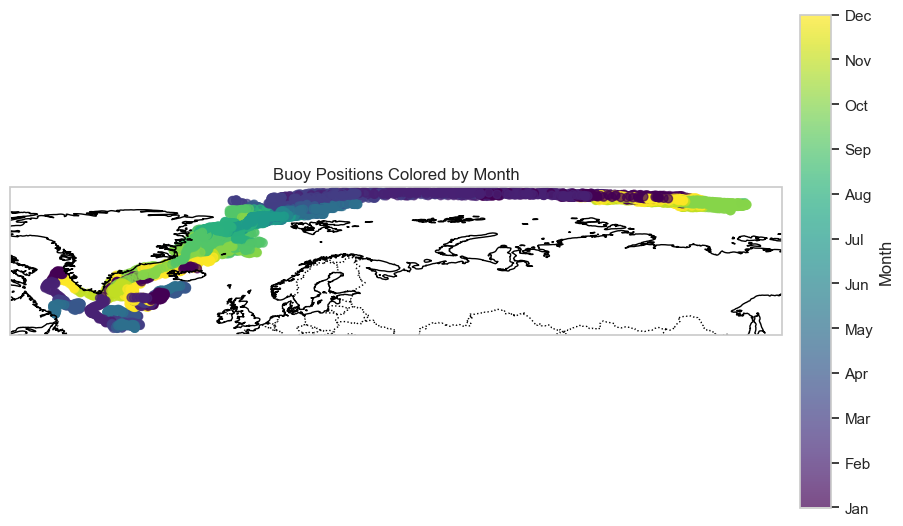

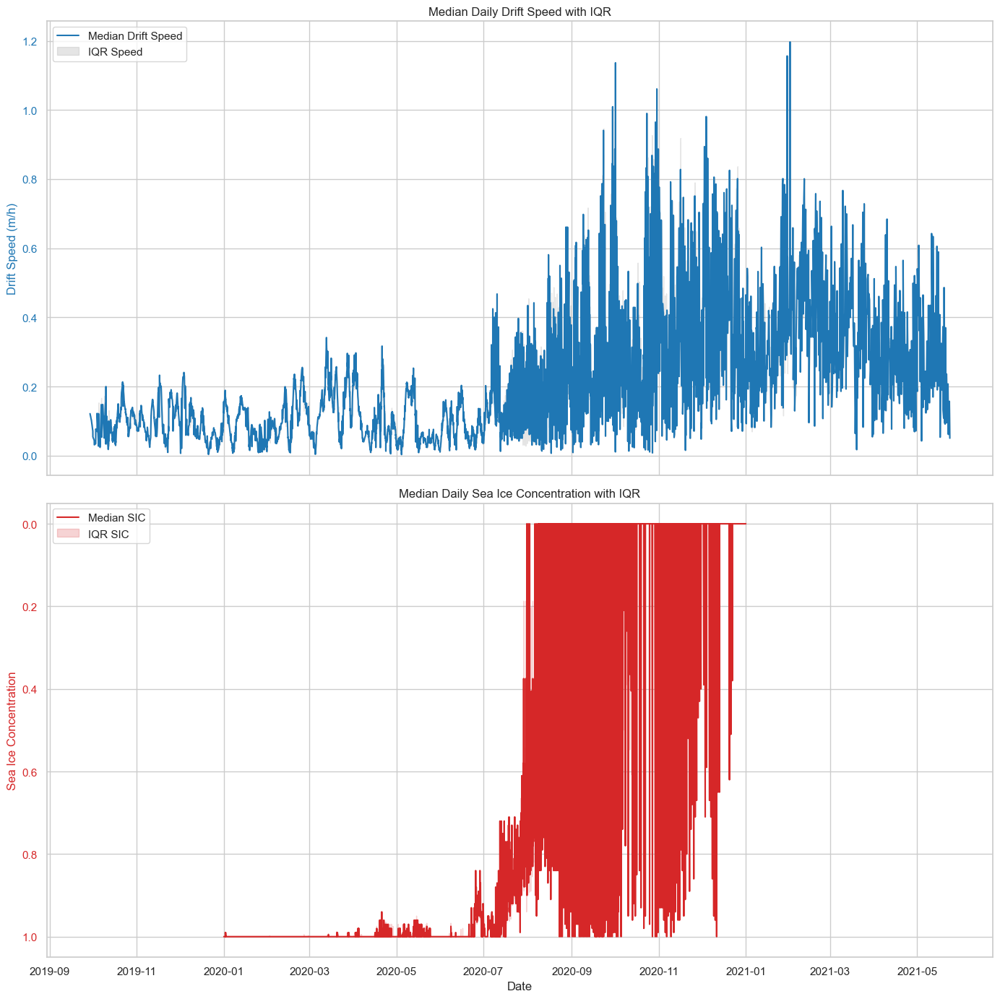

In [108]:
# Plot Daily Median Anomaly
plot_daily_median_anomaly(
    daily_median_anomaly, 
    daily_min_anomaly, 
    daily_max_anomaly, 
    title='Daily Median Drift Speed Anomalies with Ensemble Range'
)

# Plot Monthly Colored Map
plot_monthly_colored_map(
    all_positions_daily, 
    title='Buoy Positions Colored by Month'
)

# Plot Velocity and SIC Statistics
plot_velocity_and_sic(
    drift_speed_stats, 
    sic_stats, 
    title_speed='Median Daily Drift Speed with IQR', 
    title_sic='Median Daily Sea Ice Concentration with IQR'
)


Detected change points at indices: [380, 510, 835, 1140, 1290, 1440, 1565, 1850, 2160, 2440, 3270, 3560, 3650, 3755, 4375, 4470, 4690, 4750, 5415, 5510, 5645, 5785, 10355, 10540, 11192]


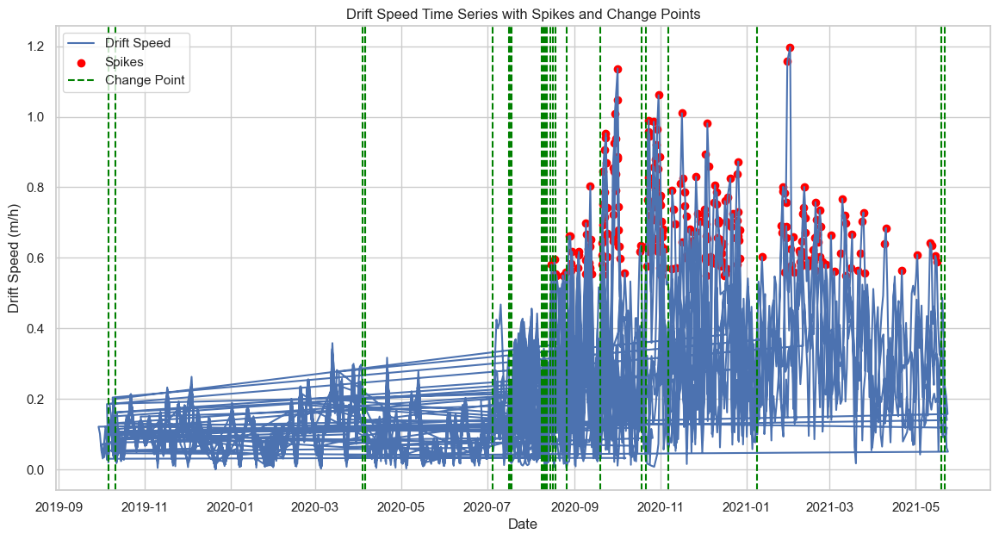

In [111]:
from ruptures import Pelt

# Initialize Pelt algorithm for change point detection
algo = Pelt(model="rbf").fit(all_positions_daily['speed'].values)

# Predict change points with a penalty value (adjust 'pen' as needed)
change_points = algo.predict(pen=10)

print(f"Detected change points at indices: {change_points}")


plt.figure(figsize=(14, 7))
plt.plot(all_positions_daily.index, all_positions_daily['speed'], label='Drift Speed')

# Define a threshold for spikes (e.g., mean + 3*std)
threshold = all_positions_daily['speed'].mean() + 3 * all_positions_daily['speed'].std()
spikes = all_positions_daily[all_positions_daily['speed'] > threshold]

# Highlight spikes
plt.scatter(spikes.index, spikes['speed'], color='red', label='Spikes')

# Mark change points
for cp in change_points:
    plt.axvline(all_positions_daily.index[cp-1], color='green', linestyle='--', label='Change Point' if cp == change_points[0] else "")

plt.xlabel('Date')
plt.ylabel('Drift Speed (m/h)')
plt.title('Drift Speed Time Series with Spikes and Change Points')
plt.legend()
plt.show()



In [118]:
def process_expedition(exp_df, expedition_id):
    """
    Processes buoy data for a single expedition.
    
    Parameters:
    - exp_df: DataFrame containing buoy data for the expedition
    - expedition_id: Identifier for the expedition
    
    Returns:
    - None (plots are displayed)
    """
    # Calculate anomalies
    exp_df['rolling_mean_speed'] = exp_df['speed'].rolling(window=24, min_periods=1).mean()
    exp_df['speed_anomaly'] = exp_df['speed'] - exp_df['rolling_mean_speed']
    
    # Resample to daily frequency using the index
    daily_median_anomaly = exp_df['speed_anomaly'].resample('D').median()
    daily_min_anomaly = exp_df['speed_anomaly'].resample('D').min()
    daily_max_anomaly = exp_df['speed_anomaly'].resample('D').max()
    
    # Calculate statistics using 'datetime_copy' for groupby operations
    drift_speed_stats = exp_df.groupby('datetime_copy').agg(
        median_speed=('speed', 'median'),
        IQR_lower_speed=('speed', lambda x: x.quantile(0.25)),
        IQR_upper_speed=('speed', lambda x: x.quantile(0.75))
    ).reset_index()
    
    sic_stats = exp_df.groupby('datetime_copy').agg(
        median_sic=('sea_ice_concentration', 'median'),
        IQR_lower_sic=('sea_ice_concentration', lambda x: x.quantile(0.25)),
        IQR_upper_sic=('sea_ice_concentration', lambda x: x.quantile(0.75))
    ).reset_index()
    
    # Plotting
    plot_daily_median_anomaly(
        daily_median_anomaly, 
        daily_min_anomaly, 
        daily_max_anomaly, 
        title=f'Daily Median Drift Speed Anomalies - Expedition {expedition_id}'
    )
    
    plot_monthly_colored_map(
        exp_df, 
        title=f'Buoy Positions Colored by Month - Expedition {expedition_id}'
    )
    
    plot_velocity_and_sic(
        drift_speed_stats, 
        sic_stats, 
        title_speed=f'Median Daily Drift Speed with IQR - Expedition {expedition_id}', 
        title_sic=f'Median Daily Sea Ice Concentration with IQR - Expedition {expedition_id}'
    )




Index(['datetime', 'longitude', 'latitude', 'buoy_id', 'x', 'y', 'u', 'v',
       'speed', 'sea_ice_concentration', 'rolling_mean_speed', 'speed_anomaly',
       'month', 'expedition_id'],
      dtype='object')


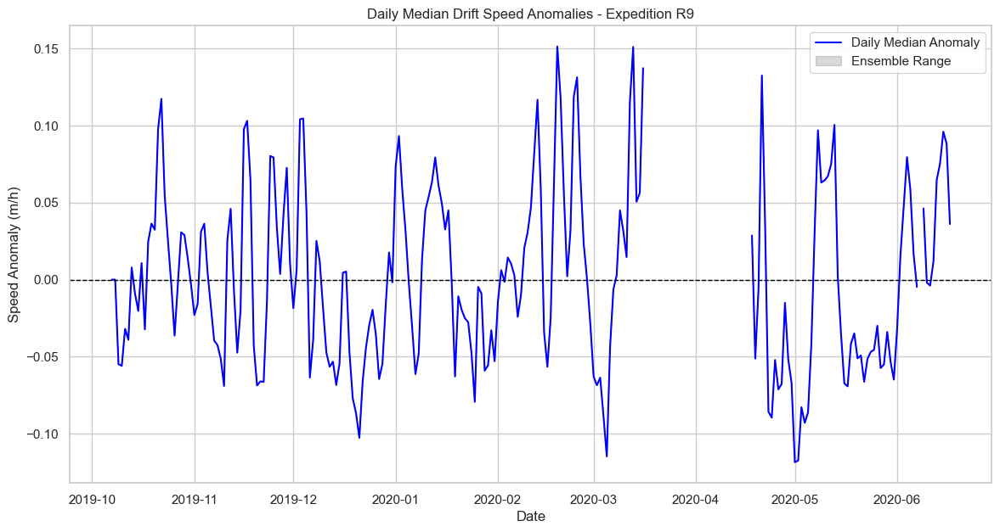

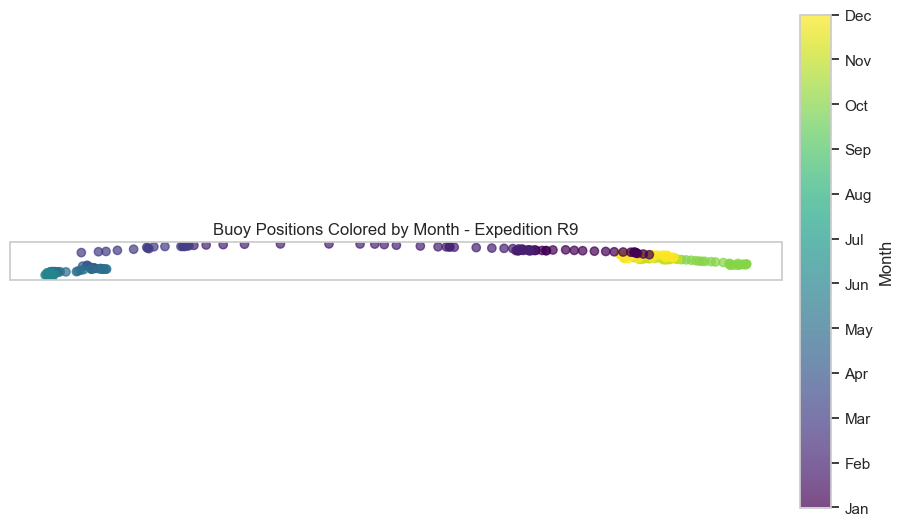

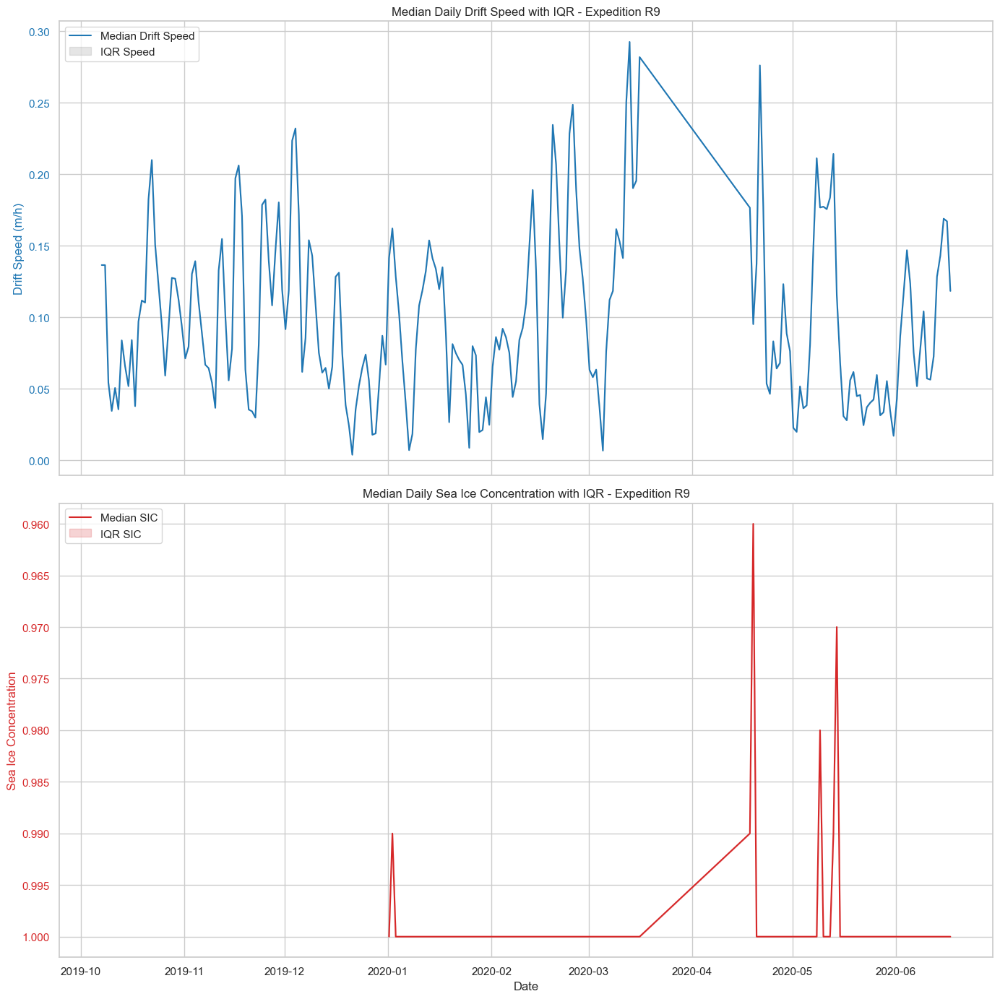

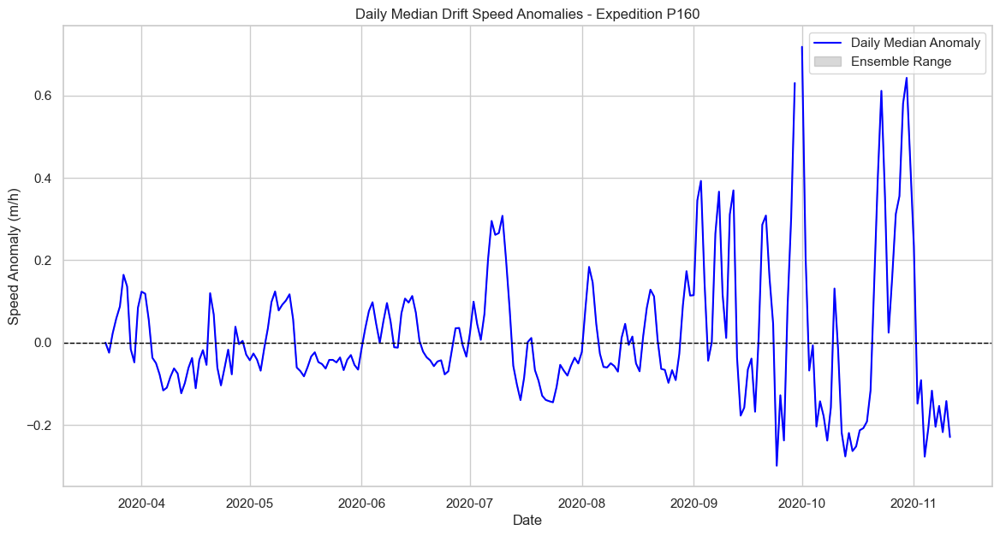

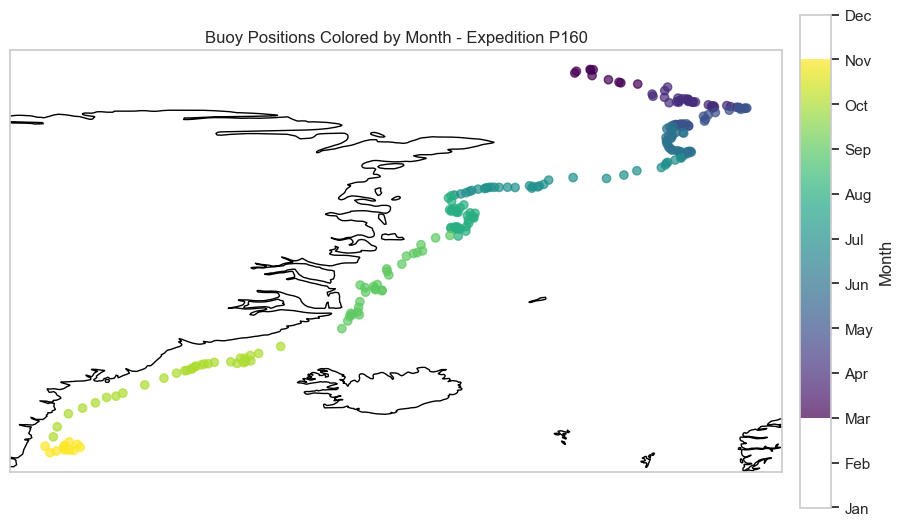

...

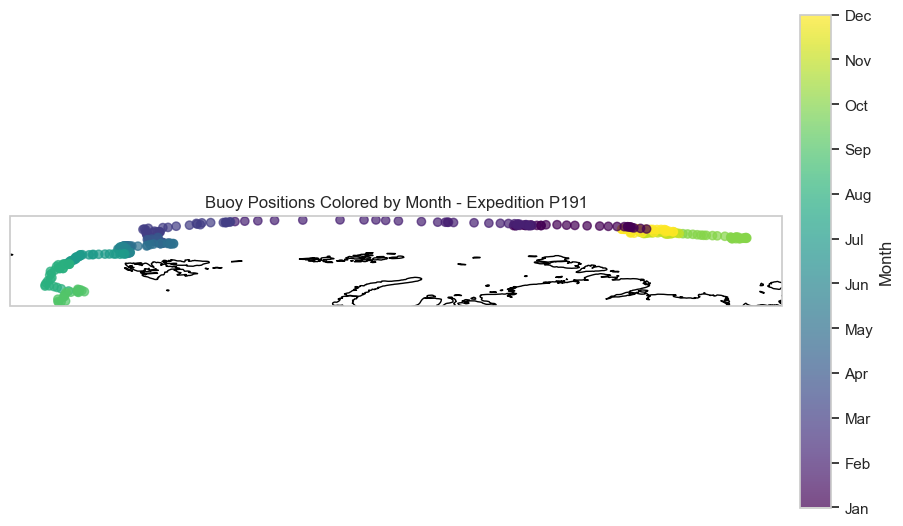

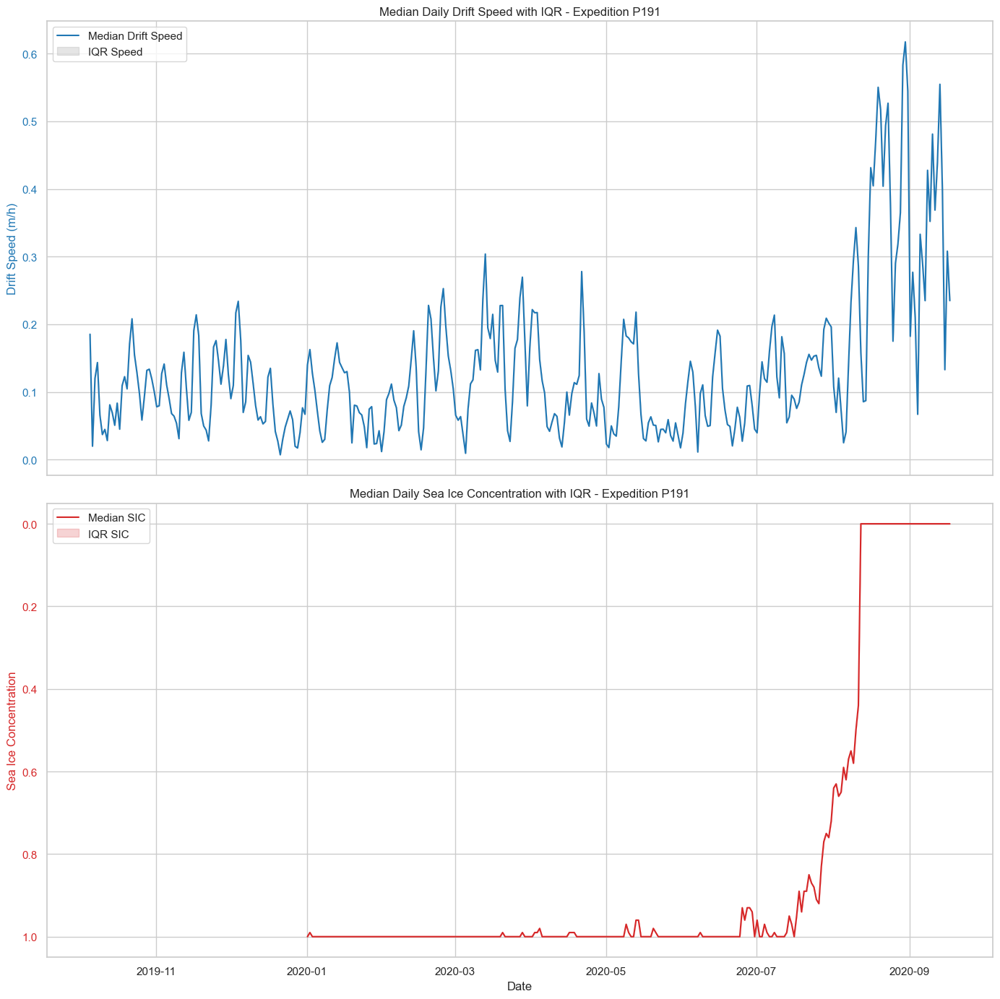

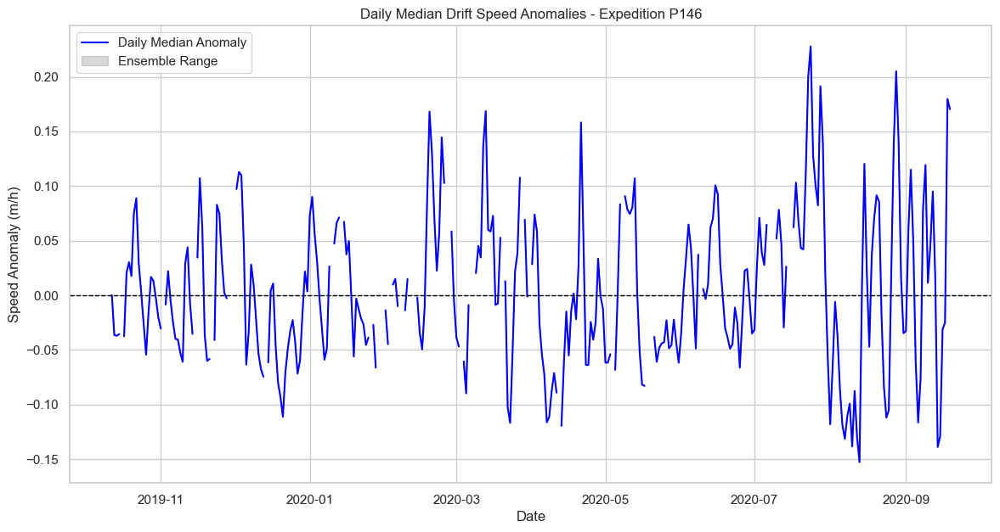

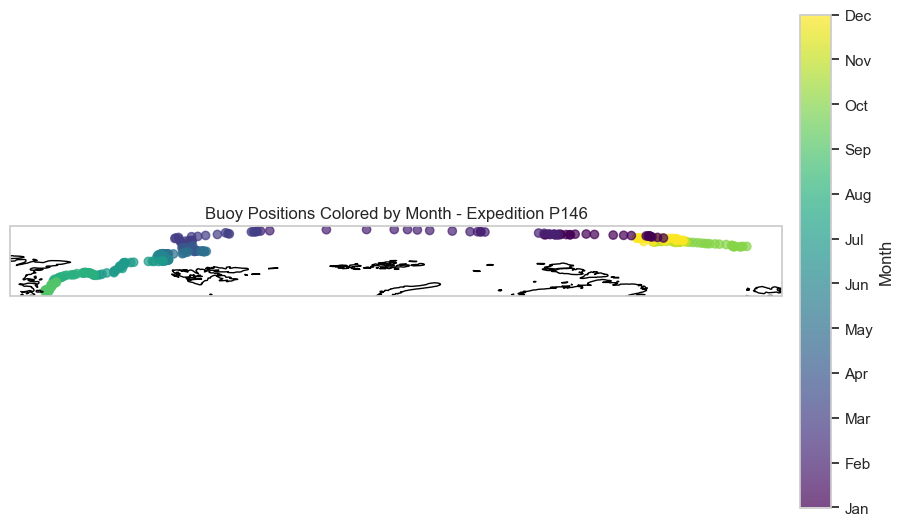

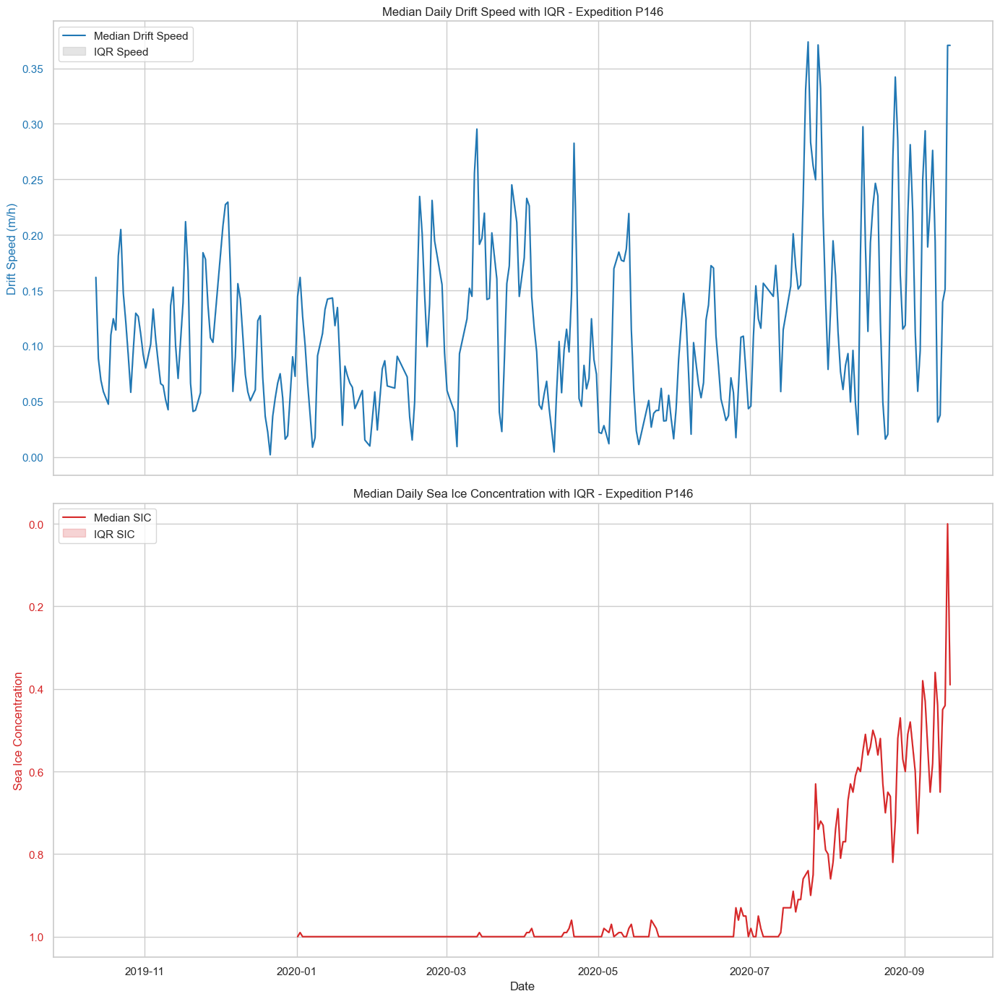

In [124]:
# If 'datetime' is already the index, reset it to make it a column
if 'datetime' not in all_positions_daily.columns:
    all_positions_daily.reset_index(inplace=True)

# Now create 'datetime_copy' as a duplicate of 'datetime'
all_positions_daily['datetime_copy'] = all_positions_daily['datetime']

# Set 'datetime_copy' as the index for further processing
all_positions_daily.set_index('datetime_copy', inplace=True)

def process_expedition(exp_df, expedition_id):
    """
    Processes buoy data for a single expedition.
    
    Parameters:
    - exp_df: DataFrame containing buoy data for the expedition
    - expedition_id: Identifier for the expedition
    
    Returns:
    - None (plots are displayed)
    """
    # Calculate anomalies
    exp_df['rolling_mean_speed'] = exp_df['speed'].rolling(window=24, min_periods=1).mean()
    exp_df['speed_anomaly'] = exp_df['speed'] - exp_df['rolling_mean_speed']
    
    # Resample to daily frequency using the index ('datetime_copy' is already the index)
    daily_median_anomaly = exp_df['speed_anomaly'].resample('D').median()
    daily_min_anomaly = exp_df['speed_anomaly'].resample('D').min()
    daily_max_anomaly = exp_df['speed_anomaly'].resample('D').max()
    
    # Calculate statistics using 'datetime_copy' index
    drift_speed_stats = exp_df.groupby(exp_df.index).agg(
        median_speed=('speed', 'median'),
        IQR_lower_speed=('speed', lambda x: x.quantile(0.25)),
        IQR_upper_speed=('speed', lambda x: x.quantile(0.75))
    ).reset_index().rename(columns={'datetime_copy': 'datetime'})  # Rename if desired
    
    sic_stats = exp_df.groupby(exp_df.index).agg(
        median_sic=('sea_ice_concentration', 'median'),
        IQR_lower_sic=('sea_ice_concentration', lambda x: x.quantile(0.25)),
        IQR_upper_sic=('sea_ice_concentration', lambda x: x.quantile(0.75))
    ).reset_index().rename(columns={'datetime_copy': 'datetime'})  # Rename if desired
    
    # Plotting
    plot_daily_median_anomaly(
        daily_median_anomaly, 
        daily_min_anomaly, 
        daily_max_anomaly, 
        title=f'Daily Median Drift Speed Anomalies - Expedition {expedition_id}'
    )
    
    plot_monthly_colored_map(
        exp_df, 
        title=f'Buoy Positions Colored by Month - Expedition {expedition_id}'
    )
    
    plot_velocity_and_sic(
        drift_speed_stats, 
        sic_stats, 
        title_speed=f'Median Daily Drift Speed with IQR - Expedition {expedition_id}', 
        title_sic=f'Median Daily Sea Ice Concentration with IQR - Expedition {expedition_id}'
    )

# Preparation steps for 'all_positions_daily'
print(all_positions_daily.columns)
all_positions_daily['datetime_copy'] = all_positions_daily['datetime']  # Duplicate 'datetime'
all_positions_daily.set_index('datetime_copy', inplace=True)  # Set index

# Define expedition_id if not already in DataFrame
all_positions_daily['expedition_id'] = all_positions_daily['buoy_id'].str.extract(r'cleaned_\d{4}([A-Z]+\d+)')
expeditions = all_positions_daily['expedition_id'].dropna().unique()

# Process each expedition
for exp_id in expeditions:
    exp_df = all_positions_daily[all_positions_daily['expedition_id'] == exp_id].copy()
    process_expedition(exp_df, exp_id)

